In [3]:
#Importação de pacotes
import warnings
warnings.filterwarnings("ignore") 
import pandas as pd
df = pd.read_csv('PreçoCasaFrança.csv')
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
import numpy as np
import joblib # Utilizado para salvar o modelo preditivo
from sklearn.preprocessing import LabelEncoder #Utilizada para fazer o OneHotEncoding
from sklearn.metrics import mean_squared_error,precision_score, recall_score, f1_score, accuracy_score, roc_auc_score, confusion_matrix
from imblearn import under_sampling, over_sampling #Utilizada para fazer o balanceamento de dados
from imblearn.over_sampling import SMOTE #Utilizada para fazer o balanceamento de dados
from sklearn.preprocessing import MinMaxScaler #Utilizada para fazer a padronização dos dados
from sklearn.metrics import r2_score # Utilizado para medir a acuracia do modelo preditivo
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
#pd.options.display.float_format = '{:.2f}'.format

In [4]:
df.head(1)

,Date mutation,Nature mutation,Valeur fonciere,No voie,Code voie,Code postal,Commune,Code departement,Code commune,Section,No plan,Nombre de lots,Type local,Surface reelle bati,Nombre pieces principales,Surface terrain,Type_voie
0,03/01/2022,Vente,"55000,00",13.0,2280,1000.0,BOURG-EN-BRESSE,1,53,AM,102,1,Appartement,24.0,1.0,NaN,RUE RUE RUE DE LA LIBERTE


In [5]:
df.describe()

,No voie,Code postal,Code commune,No plan,Nombre de lots,Surface reelle bati,Nombre pieces principales,Surface terrain
count,2.482658e+06,3.764712e+06,3.803885e+06,3.803885e+06,3.803885e+06,2.283343e+06,2.283343e+06,2.516996e+06
mean,6.565564e+02,5.108660e+04,2.063362e+02,4.047724e+02,4.712206e-01,6.475469e+01,1.757658e+00,2.655631e+03
std,1.933208e+03,2.745389e+04,1.656967e+02,5.712071e+02,8.754527e-01,5.476260e+02,2.077233e+00,1.605604e+04
min,1.000000e+00,1.000000e+03,1.000000e+00,1.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
25%,8.000000e+00,3.012600e+04,7.500000e+01,8.400000e+01,0.000000e+00,0.000000e+00,0.000000e+00,2.400000e+02
50%,2.500000e+01,4.946000e+04,1.710000e+02,2.190000e+02,0.000000e+00,3.000000e+01,1.000000e+00,5.910000e+02
75%,9.200000e+01,7.610000e+04,2.940000e+02,4.950000e+02,1.000000e+00,8.000000e+01,3.000000e+00,1.550000e+03
max,9.999000e+03,9.749000e+04,9.090000e+02,9.901000e+03,1.880000e+02,2.900000e+05,9.000000e+01,4.625500e+06


# IMPORTAÇÃO DE DADOS

In [6]:
df_traduzida = df.rename(columns={'Date mutation':'DataTransição','Nature mutation':'Natureza','Valeur fonciere':'Preço','No voie':'NúmeroRua','Code voie':'CodígoRua','Code postal':'CodigoPostal','Commune':'Localização','Code departement':'CodígoDepartamento','Code commune':'CodigoLocalização','Section':'SeçãoInformações','No plan':'NúmeroPlano','Nombre de lots':'QuantidadeLotes','Type local':'TipoPropiedade','Surface reelle bati':'AreaConstruída','Nombre pieces principales':'NúmeroCômodos','Surface terrain':'AreaTotal','Type_voie':'TipoRua'})
df_traduzida.head(1)

,DataTransição,Natureza,Preço,NúmeroRua,CodígoRua,CodigoPostal,Localização,CodígoDepartamento,CodigoLocalização,SeçãoInformações,NúmeroPlano,QuantidadeLotes,TipoPropiedade,AreaConstruída,NúmeroCômodos,AreaTotal,TipoRua
0,03/01/2022,Vente,"55000,00",13.0,2280,1000.0,BOURG-EN-BRESSE,1,53,AM,102,1,Appartement,24.0,1.0,NaN,RUE RUE RUE DE LA LIBERTE


# TRATAMENTO E MANIPULAÇÃO DE DADOS

In [7]:
df_traduzida.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3803885 entries, 0 to 3803884
Data columns (total 17 columns):
 #   Column              Dtype  
---  ------              -----  
 0   DataTransição       object 
 1   Natureza            object 
 2   Preço               object 
 3   NúmeroRua           float64
 4   CodígoRua           object 
 5   CodigoPostal        float64
 6   Localização         object 
 7   CodígoDepartamento  object 
 8   CodigoLocalização   int64  
 9   SeçãoInformações    object 
 10  NúmeroPlano         int64  
 11  QuantidadeLotes     int64  
 12  TipoPropiedade      object 
 13  AreaConstruída      float64
 14  NúmeroCômodos       float64
 15  AreaTotal           float64
 16  TipoRua             object 
dtypes: float64(5), int64(3), object(9)
memory usage: 493.4+ MB


### CONVERTEDNO VARIAVÉIS

In [8]:
df_traduzida['Preço'] = pd.to_numeric(df_traduzida["Preço"].str.replace("Rs"," ").str.replace(',' ,'').str.replace('.', '').str.replace('Negotiable', '').str.replace(" ", ''),downcast="float")

In [9]:
df_traduzida['DataTransição'] = pd.to_datetime(df_traduzida['DataTransição'], format='%d/%m/%Y')


### EXCLUINDO VARIAVÉIS QUE NÃO SERÃO ÚTEIS

In [10]:
del df_traduzida['CodígoRua']
del df_traduzida['CodigoLocalização']
del df_traduzida['NúmeroRua']
del df_traduzida['CodigoPostal']
del df_traduzida['CodígoDepartamento']

### TRATANDO VALORES NULOS E DUPLICADOS

In [11]:
df_traduzida.describe()

,DataTransição,Preço,NúmeroPlano,QuantidadeLotes,AreaConstruída,NúmeroCômodos,AreaTotal
count,3803885,3.779164e+06,3.803885e+06,3.803885e+06,2.283343e+06,2.283343e+06,2.516996e+06
mean,2022-06-20 02:55:35.917254144,7.042585e+07,4.047724e+02,4.712206e-01,6.475469e+01,1.757658e+00,2.655631e+03
min,2022-01-01 00:00:00,1.000000e+00,1.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
25%,2022-03-26 00:00:00,7.871900e+06,8.400000e+01,0.000000e+00,0.000000e+00,0.000000e+00,2.400000e+02
50%,2022-06-15 00:00:00,1.775000e+07,2.190000e+02,0.000000e+00,3.000000e+01,1.000000e+00,5.910000e+02
75%,2022-09-13 00:00:00,3.200000e+07,4.950000e+02,1.000000e+00,8.000000e+01,3.000000e+00,1.550000e+03
max,2022-12-31 00:00:00,1.003401e+11,9.901000e+03,1.880000e+02,2.900000e+05,9.000000e+01,4.625500e+06
std,NaN,5.876489e+08,5.712071e+02,8.754527e-01,5.476260e+02,2.077233e+00,1.605604e+04


In [12]:
(df_traduzida.isnull().sum() / len(df_traduzida['Preço']))*100

DataTransição        0.000000
Natureza             0.000000
Preço                0.649888
Localização          0.000000
SeçãoInformações     0.004075
NúmeroPlano          0.000000
QuantidadeLotes      0.000000
TipoPropiedade      39.918478
AreaConstruída      39.973396
NúmeroCômodos       39.973396
AreaTotal           33.830912
TipoRua              1.029290
dtype: float64

In [13]:
m = df_traduzida['Preço'].median()
df_traduzida['Preço'] = df_traduzida['Preço'].fillna(m)

In [14]:
me = df_traduzida['NúmeroCômodos'].mean()
df_traduzida['NúmeroCômodos'] = df_traduzida['NúmeroCômodos'].fillna(me)

In [15]:
med = df_traduzida['AreaTotal'].median()
df_traduzida['AreaTotal'] = df_traduzida['AreaTotal'].fillna(med)

In [16]:
medi= df_traduzida['AreaConstruída'].median()
df_traduzida['AreaConstruída'] = df_traduzida['AreaConstruída'].fillna(medi)

In [17]:
df_traduzida['TipoPropiedade'] = df_traduzida['TipoPropiedade'].fillna('kitNet')


In [18]:
df_traduzida = df_traduzida.dropna()

In [19]:
df_traduzida.duplicated().sum()

477516

In [20]:
df_traduzida = df_traduzida.drop_duplicates()

In [21]:
df_traduzida.shape

(3287066, 12)

# ANÁLISE EXPLORATÓRIA

### ESTATÍSTICA

In [22]:

desc_stats = df_traduzida.describe()


desc_stats_rounded = desc_stats.round(2)


formatted_desc_stats = desc_stats_rounded.applymap("{:.2f}".format)
print(formatted_desc_stats)


      DataTransição            Preço NúmeroPlano QuantidadeLotes  \
count    3287066.00       3287066.00  3287066.00      3287066.00   
mean            .2f      41800163.01      409.63            0.44   
min             .2f             1.00        1.00            0.00   
25%             .2f       7000000.00       84.00            0.00   
50%             .2f      16585000.00      221.00            0.00   
75%             .2f      29940000.00      505.00            1.00   
max             .2f  100340147000.00     9901.00          188.00   
std             nan     419599048.17      570.06            0.87   

      AreaConstruída NúmeroCômodos   AreaTotal  
count     3287066.00    3287066.00  3287066.00  
mean           56.41          1.91     2027.96  
min             0.00          0.00        0.00  
25%            30.00          1.00      381.00  
50%            30.00          1.76      591.00  
75%            60.00          2.00      953.00  
max        290000.00         90.00  4625500.

### MODA

In [23]:
from statistics import mode
mode(df_traduzida['Preço'])

15000000.0

In [24]:
mode(df_traduzida['NúmeroPlano'])

1

In [25]:
mode(df_traduzida['QuantidadeLotes'])

0

In [26]:
mode(df_traduzida['AreaConstruída'])

30.0

In [27]:
mode(df_traduzida['NúmeroCômodos'])

1.757657960280168

In [28]:
mode(df_traduzida['AreaTotal'])

591.0

### ASSIMETRIA

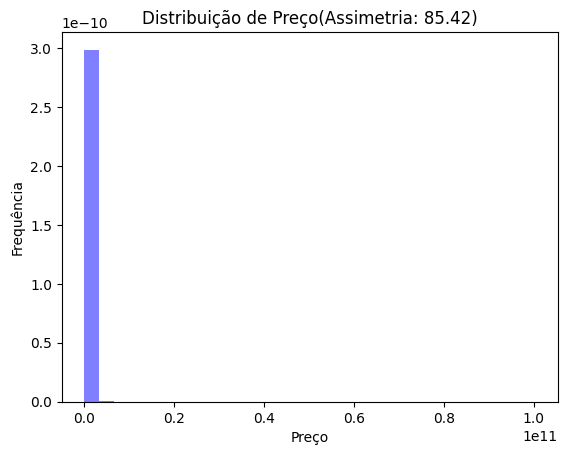

In [29]:
import matplotlib.pyplot as plt
from scipy.stats import skew

Preço = df_traduzida['Preço']

# Calculando a assimetria dos dados
assimetria = skew(Preço)

# Criando um histograma para visualizar a distribuição dos dados
plt.hist(Preço, bins=30, density=True, alpha=0.5, color='b')

# Adicionando informações ao gráfico
plt.title(f'Distribuição de Preço(Assimetria: {assimetria:.2f})')
plt.xlabel('Preço')
plt.ylabel('Frequência')

# Exibindo o gráfico
plt.show()

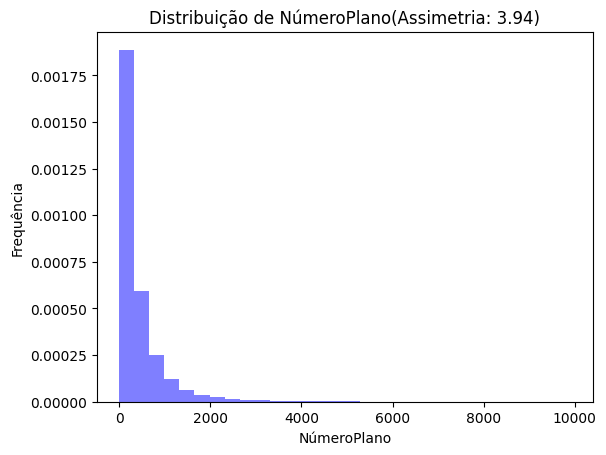

In [30]:
NúmeroPlano = df_traduzida['NúmeroPlano']

assimetria = skew(NúmeroPlano)


plt.hist(NúmeroPlano, bins=30, density=True, alpha=0.5, color='b')

plt.title(f'Distribuição de NúmeroPlano(Assimetria: {assimetria:.2f})')
plt.xlabel('NúmeroPlano')
plt.ylabel('Frequência')

plt.show()

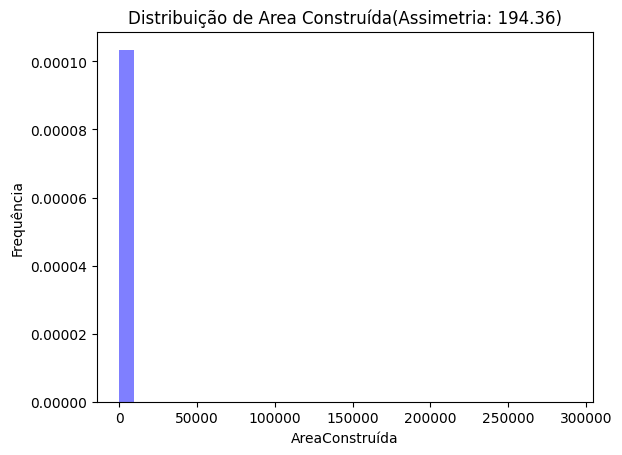

In [31]:
AreaConstruída = df_traduzida['AreaConstruída']

assimetria = skew(AreaConstruída)


plt.hist(AreaConstruída, bins=30, density=True, alpha=0.5, color='b')

plt.title(f'Distribuição de Area Construída(Assimetria: {assimetria:.2f})')
plt.xlabel('AreaConstruída')
plt.ylabel('Frequência')

plt.show()

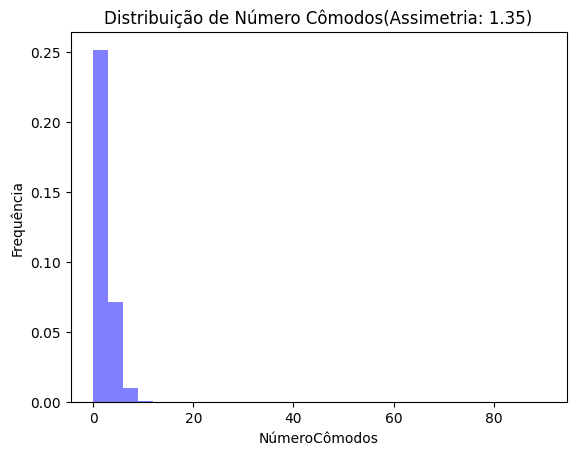

In [32]:
NúmeroCômodos = df_traduzida['NúmeroCômodos']

assimetria = skew(NúmeroCômodos)


plt.hist(NúmeroCômodos, bins=30, density=True, alpha=0.5, color='b')

plt.title(f'Distribuição de Número Cômodos(Assimetria: {assimetria:.2f})')
plt.xlabel('NúmeroCômodos')
plt.ylabel('Frequência')

plt.show()

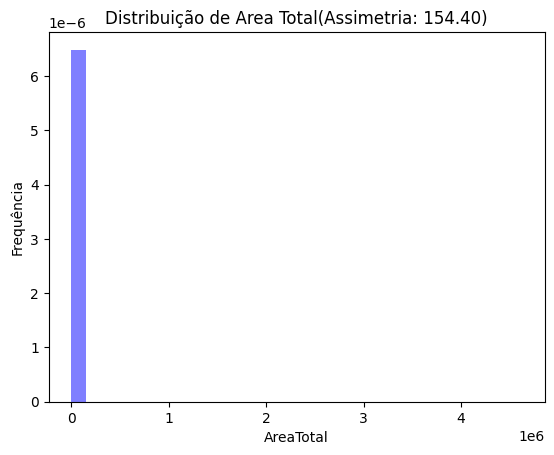

In [33]:
AreaTotal = df_traduzida['AreaTotal']

assimetria = skew(AreaTotal)


plt.hist(AreaTotal, bins=30, density=True, alpha=0.5, color='b')

plt.title(f'Distribuição de Area Total(Assimetria: {assimetria:.2f})')
plt.xlabel('AreaTotal')
plt.ylabel('Frequência')

plt.show()

### CURTOSE

In [34]:
df_traduzida['Preço'].kurt()

11473.222360748303

In [35]:
df_traduzida['NúmeroPlano'].kurt()

25.29093324083368

In [36]:
df_traduzida['AreaConstruída'].kurt()

86549.79153273134

In [37]:
df_traduzida['AreaTotal'].kurt()

45044.321763673775

In [38]:
df_traduzida['QuantidadeLotes'].kurt()

2307.0769169935425

### HISTOGRAMA

array([[<Axes: title={'center': 'DataTransição'}>,
        <Axes: title={'center': 'Preço'}>,
        <Axes: title={'center': 'NúmeroPlano'}>],
       [<Axes: title={'center': 'QuantidadeLotes'}>,
        <Axes: title={'center': 'AreaConstruída'}>,
        <Axes: title={'center': 'NúmeroCômodos'}>],
       [<Axes: title={'center': 'AreaTotal'}>, <Axes: >, <Axes: >]],
      dtype=object)

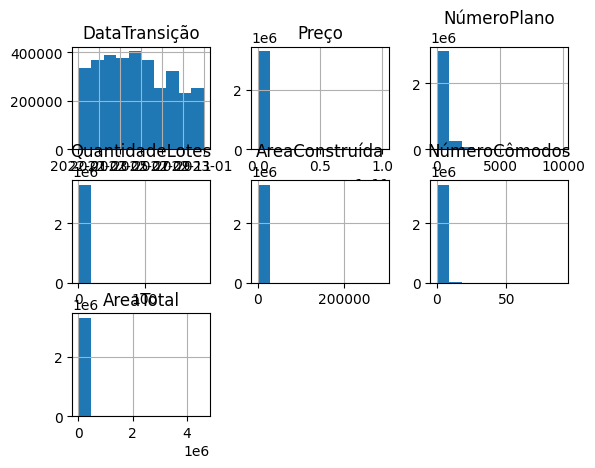

In [39]:
df_traduzida.hist()

### TOTAL DE VALORES UNICOS EM CADA VARIAVEL

In [40]:
valores_unicos = []
for i in df_traduzida.columns[0:12].tolist():
    print(i, ':', len(df_traduzida[i].astype(str).value_counts()))
    valores_unicos.append(len(df_traduzida[i].astype(str).value_counts()))

DataTransição : 356
Natureza : 6
Preço : 146781
Localização : 30580
SeçãoInformações : 583
NúmeroPlano : 6592
QuantidadeLotes : 71
TipoPropiedade : 5
AreaConstruída : 4534
NúmeroCômodos : 47
AreaTotal : 44666
TipoRua : 476128


### VERIFICANDO SE HÁ POSSIBILIDADE DE OUTLIERS E TRATAMENTO DO MESMO

Preço : float64
NúmeroPlano : int64
QuantidadeLotes : int64
AreaConstruída : float64
NúmeroCômodos : float64
AreaTotal : float64


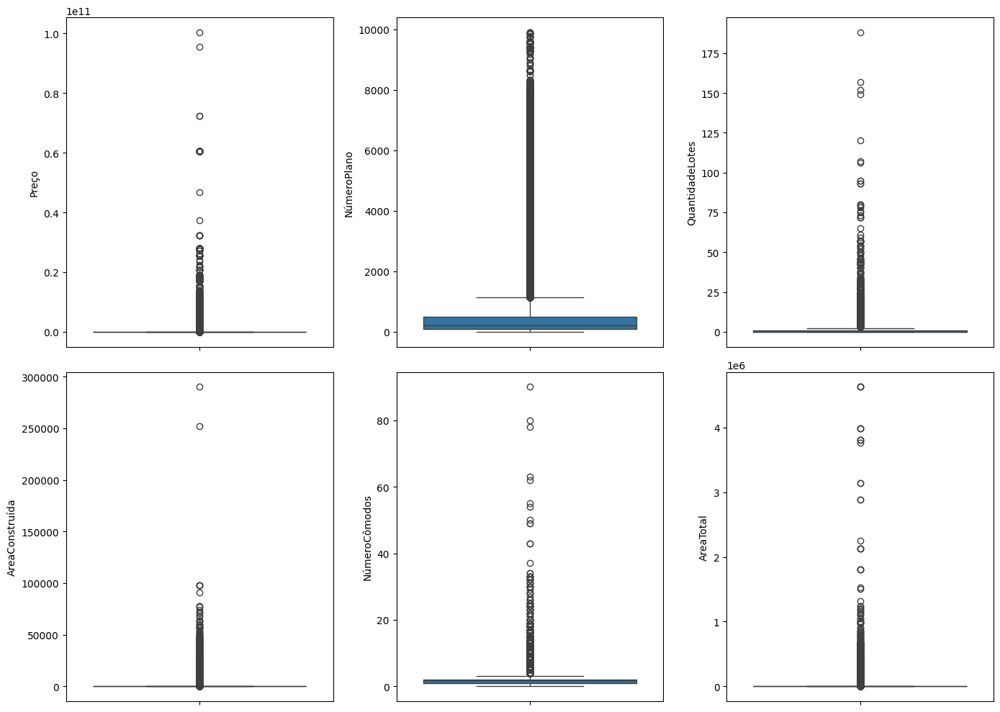

In [41]:
variaveis_numericas = []
for i in df_traduzida.columns[0:16].tolist():
        if df_traduzida.dtypes[i] == 'int64' or df_traduzida.dtypes[i] == 'float64':            
            print(i, ':' , df_traduzida.dtypes[i]) 
            variaveis_numericas.append(i)
 
    
    
    
plt.rcParams["figure.figsize"] = [14.00, 10.00]
plt.rcParams["figure.autolayout"] = True

plt.rcParams['font.size'] = 10 
plt.rcParams['axes.titlesize'] = 20

f, axes = plt.subplots(2, 3) #8 linhas e 4 colunas

linha = 0
coluna = 0
for i in variaveis_numericas:
    sns.boxplot(data = df_traduzida, y=i, ax=axes[linha][coluna])
    coluna += 1
    if coluna == 3:
        linha += 1
        coluna = 0            

plt.show() 

### VERIFICANDO AS POSSIVEIS CORRELAÇÃO

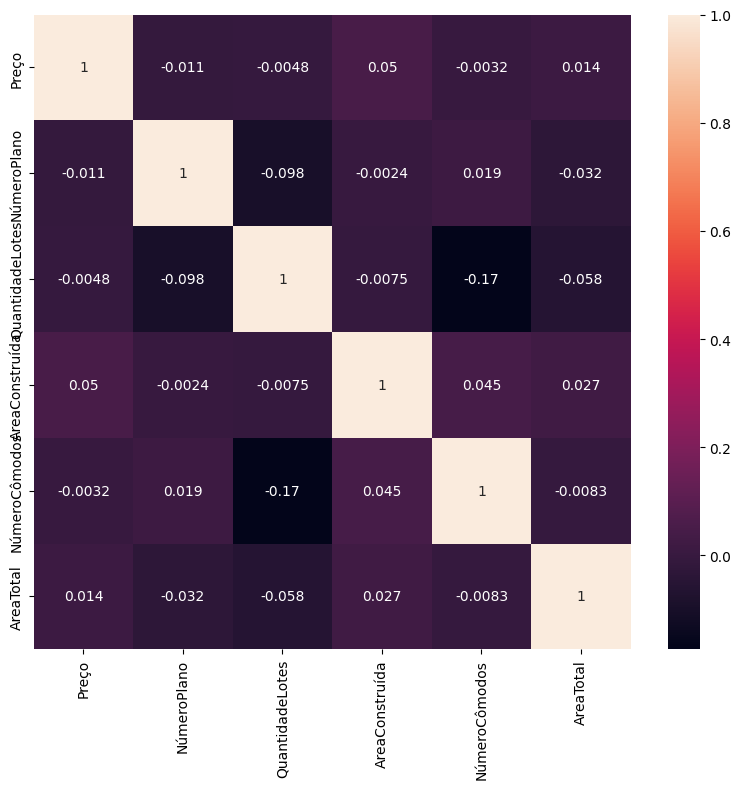

In [42]:

df_numeric = df_traduzida.select_dtypes(include=['float64', 'int64'])

plt.rcParams['xtick.labelsize'] = 10
plt.rcParams['ytick.labelsize'] = 10
plt.rcParams['font.size'] = 10
plt.rcParams['axes.titlesize'] = 20
plt.rcParams["figure.figsize"] = [8.00, 8.00]
plt.rcParams["figure.autolayout"] = True


sns.heatmap(df_numeric.corr(), annot=True)
plt.show()

### ANALISANDO DADOS COM PYHWALKER

In [43]:
import pygwalker as pyg
pyg.walk(df_traduzida)

Box(children=(HTML(value='<div id="ifr-pyg-0" style="height: auto">\n    <head>\n        <meta http-equiv="Con…

# ANÁLISE DE DADOS

## AGRUPAMENTO

In [44]:
df_traduzida.head(1)

,DataTransição,Natureza,Preço,Localização,SeçãoInformações,NúmeroPlano,QuantidadeLotes,TipoPropiedade,AreaConstruída,NúmeroCômodos,AreaTotal,TipoRua
0,2022-01-03,Vente,5500000.0,BOURG-EN-BRESSE,AM,102,1,Appartement,24.0,1.0,591.0,RUE RUE RUE DE LA LIBERTE


In [45]:
df_traduzida.groupby(["Natureza"]).size()

Natureza
Adjudication                             4662
Echange                                 32008
Expropriation                             537
Vente                                 3147731
Vente en l'état futur d'achèvement      90565
Vente terrain à bâtir                   11563
dtype: int64

In [46]:
df_traduzida.groupby(["Localização"]).size()

Localização
AAST                                  5
ABAINVILLE                           36
ABANCOURT                            57
ABAUCOURT                            10
ABAUCOURT-HAUTECOURT                 16
ABBANS DESSOUS                        6
ABBANS DESSUS                        48
ABBARETZ                            177
ABBECOURT                            82
ABBENANS                             18
ABBEVILLE                           736
ABBEVILLE ST LUCIEN                  28
ABBEVILLE-LA-RIVIERE                 34
ABBEVILLE-LES-CONFLANS               15
ABBEVILLERS                          64
ABEILHAN                             93
ABELCOURT                            15
ABERE                                 2
ABERGEMENT STE COLOMBE L             75
ABERGEMENT-DE-CUISERY (L )           48
ABERGEMENT-DE-VAREY (L )             17
ABERGEMENT-LA-RONCE                  25
ABERGEMENT-LE-GRAND                  13
ABERGEMENT-LE-PETIT                   4
ABERGEMENT-LES-THESY        

In [47]:
df_traduzida.groupby(["SeçãoInformações"]).size()

SeçãoInformações
A     244420
AA     33458
AB    142911
AC    111686
AD     98497
AE     87402
AF      2858
AG      3250
AH     80106
AI     72527
AJ      2829
AK     66444
AL     61943
AM     56836
AN     51484
AO     45845
AP     44037
AQ      2561
AR     42647
AS     37851
AT     36090
AU      1721
AV     34869
AW     31196
AX     30345
AY     28254
AZ     25443
B     232443
BA      9103
BB      8052
BC     24632
BD     24750
BE     23110
BF      1556
BG      1417
BH     21106
BI     21504
BJ      1729
BK     19572
BL     18629
BM     16867
BN     15388
BO     15116
BP     14893
BQ       950
BR     13325
BS     12905
BT     12171
BU      1180
BV     11970
BW     10799
BX     10909
BY     10379
BZ     10102
C     162957
CA      3980
CB      3228
CC      2682
CD      9649
CE      9217
CF       804
CG      1245
CH      7891
CI      7576
CJ       800
CK      7972
CL      7653
CM      7633
CN      7443
CO      6784
CP      6190
CQ       595
CR      5313
CS      5252
CT      5034
CU      

In [48]:
df_traduzida.groupby(["TipoPropiedade"]).size()

TipoPropiedade
Appartement                                  485463
Dépendance                                   706099
Local industriel. commercial ou assimilé     105360
Maison                                       626325
kitNet                                      1363819
dtype: int64

In [49]:
df_traduzida.groupby(["TipoRua"]).size()

TipoRua
036                                              1
078                                              1
1 ALLEE NORD DES PAINS PER                       3
1 CANTON DE FONTAINE FINET                       2
1 CANTON DE LA COMBE JACQU                       1
1 CANTON DE LA FONTAINE                          1
10E QRT DES VIDELAS                              3
113B RUE JAURES CL JOSEPH                        8
136                                              1
1E ET 2E TRANCHEE DES GRAV                       1
1ER CANTON DES HERBUES                           1
1ER ENTRETENANT                                  2
1ER QRT DU CHATEAU                               7
1ERE 2EME POINTIERE DES GR                      13
1ERE IMP GUILLAUME RIBIER                        3
1ERE IMP SOURDERIE                               4
1ERE POIN AU DSU CHEM DE H                       1
1ERE POINTIERE SUR CHANTEL                       1
1ERE POINTIERE SUR LA COBR                       2
1RES DU CAILLOU        

## ANALISANDO OS PAISES

### MAIS VENDIDAS, LUCROS E MÉDIA DOS PREÇOS

In [50]:
total_compras = df_traduzida.groupby(["Localização"])["Preço"].sum().rename("Preço total das Casas")
media_compra = df_traduzida.groupby(["Localização"])["Preço"].mean().rename("Média das Casas")
numero = df_traduzida.groupby(["Localização"])["Preço"].count().rename('Número de Casas')
# Dataframe para os resultados
dados_usuarios = pd.DataFrame({"Preço total das Casas": total_compras, "Média das Casas":media_compra,"Número de Casas":numero})

# Manipulação de Dados
dados_usuarios ["Preço total das Casas"] = dados_usuarios["Preço total das Casas"].map("${:,.2f}".format)
dados_usuarios ["Média das Casas"] = dados_usuarios["Média das Casas"].map("${:,.2f}".format)
dados_usuarios.sort_values("Número de Casas", ascending=False).head(5)

,Preço total das Casas,Média das Casas,Número de Casas
Localização,,,
TOULOUSE,"$865,538,538,383.00","$37,475,690.09",23096
NICE,"$914,986,793,954.00","$41,030,797.94",22300
NANTES,"$526,108,606,375.00","$33,811,607.09",15560
MONTPELLIER,"$456,059,315,334.00","$33,777,167.48",13502
BORDEAUX,"$676,292,135,245.00","$52,806,444.54",12807


### ANALISANDO LUCROS PELA DATA

In [51]:
#Avaliar o período dos dados coletados
inicio = pd.to_datetime(df_traduzida['DataTransição']).dt.date.min()
fim = pd.to_datetime(df_traduzida['DataTransição']).dt.date.max()
print('Período dos dados - De:', inicio, 'Até:',fim)

Período dos dados - De: 2022-01-01 Até: 2022-12-31


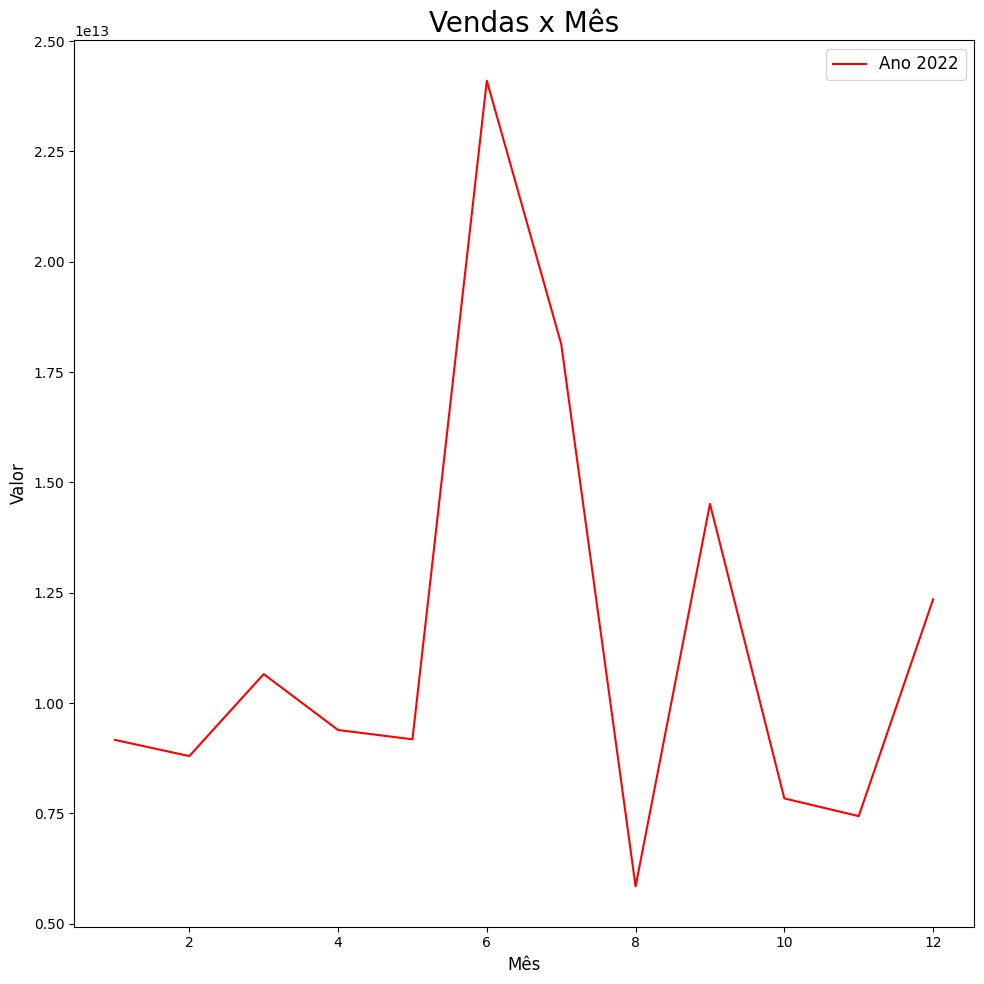

In [52]:
# Reiniciando o matplotlib
import matplotlib.pyplot as plt
from importlib import reload
plt=reload(plt)

# Formatando tamanho do grafico
plt.rcParams["figure.figsize"] = [10.00, 10.00]
plt.rcParams['font.size'] = 12 
plt.rcParams['axes.titlesize'] = 20


#Convertendo o campo DATA_VENDA para DateTime
df_traduzida['DataTransição'] = pd.to_datetime(df_traduzida['DataTransição'], format="%d/%m/%Y")


#Selecionando apenas as vendas de 2021
df_2022 = df_traduzida[df_traduzida["DataTransição"].dt.year == 2022]

# Comparativo de lucro bruto por mês
df_2022.groupby(df_2022["DataTransição"].dt.month)["Preço"].sum().plot(color='red', label='Ano 2022')

plt.title("Vendas x Mês")
plt.ylabel("Valor")
plt.xlabel("Mês")

plt.legend()
plt.show()

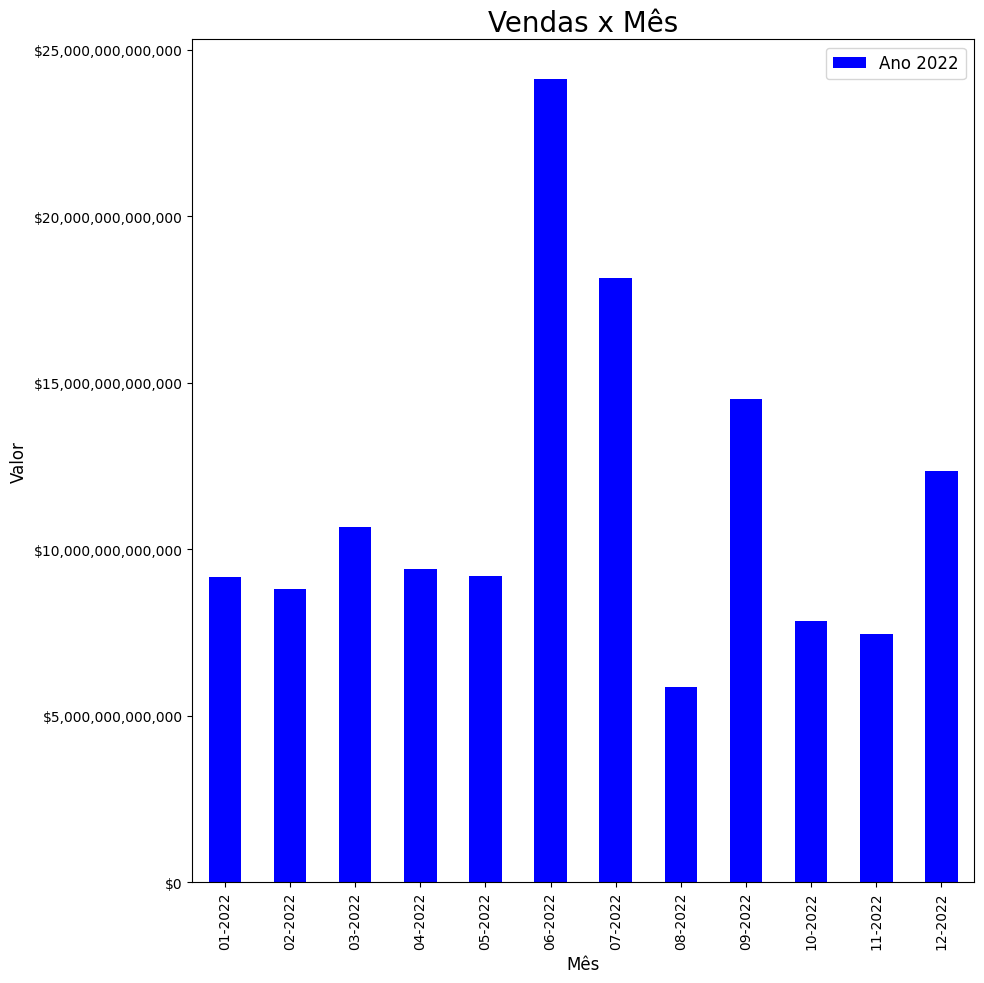

In [53]:
import matplotlib.pyplot as plt
import matplotlib.ticker as tick

# Substitua "DataTransição" pelo nome correto da coluna de data em seu DataFrame, se necessário.
grouped_data = df_2022.groupby(df_2022["DataTransição"].dt.strftime('%m-%Y'))["Preço"].sum()

fig, ax = plt.subplots()

# Use FuncFormatter para formatar os valores do eixo y
def formatar_valores(valor, _):
    return "${:,.0f}".format(valor)

grouped_data.plot.bar(color='blue', label='Ano 2022', ax=ax)

# Formatação dos valores do eixo y
ax.yaxis.set_major_formatter(tick.FuncFormatter(formatar_valores))

plt.title("Vendas x Mês")
plt.ylabel("Valor")
plt.xlabel("Mês")
plt.legend()
plt.show()


### MÉDIA DOS LOTES, ÁREAS CONSTRUIDA, CÔMODOS E ÁREA TOTAL 

In [54]:
quantidade = df_traduzida.groupby(["Localização"])["QuantidadeLotes"].count().rename("Número Total")
medialotes = df_traduzida.groupby(["Localização"])["QuantidadeLotes"].median().rename("Média Dos Lotes")
mediaconstruida = df_traduzida.groupby(["Localização"])["AreaConstruída"].median().rename("Média Da Área Construida")
mediacomodos = df_traduzida.groupby(["Localização"])["NúmeroCômodos"].median().rename('Média Dos Cômodos')
mediaareatotal = df_traduzida.groupby(["Localização"])["AreaTotal"].median().rename('Média Da Area Total')
# Dataframe para os resultados
dados_usuarios = pd.DataFrame({"Número Total":quantidade,"Média Dos Lotes": medialotes, "Média Da Área Construida":mediacomodos,"Média Dos Cômodos":mediacomodos, "Média Da Area Total":mediaareatotal})

dados_usuarios.sort_values("Número Total", ascending=False).head(10)

,Número Total,Média Dos Lotes,Média Da Área Construida,Média Dos Cômodos,Média Da Area Total
Localização,,,,,
TOULOUSE,23096,1.0,1.000000,1.000000,591.0
NICE,22300,1.0,1.000000,1.000000,591.0
NANTES,15560,1.0,1.000000,1.000000,591.0
MONTPELLIER,13502,1.0,1.000000,1.000000,591.0
BORDEAUX,12807,1.0,1.757658,1.757658,591.0
SAINT-ETIENNE,10632,1.0,1.000000,1.000000,591.0
RENNES,10415,1.0,1.000000,1.000000,591.0
LILLE,10290,1.0,1.000000,1.000000,591.0
PARIS 15,8755,2.0,0.000000,0.000000,591.0


## ANALISANDO AS RUAS

### MAIS VENDIDAS, LUCROS E MÉDIA DOS PREÇOS

In [55]:
total_compras = df_traduzida.groupby(["TipoRua"])["Preço"].sum().rename("Preço total das Casas")
media_compra = df_traduzida.groupby(["TipoRua"])["Preço"].mean().rename("Média das Casas")
numero = df_traduzida.groupby(["TipoRua"])["Preço"].count().rename('Número de Casas')
# Dataframe para os resultados
dados_usuarios = pd.DataFrame({"Preço total das Casas": total_compras, "Média das Casas":media_compra,"Número de Casas":numero})

# Manipulação de Dados
dados_usuarios ["Preço total das Casas"] = dados_usuarios["Preço total das Casas"].map("${:,.2f}".format)
dados_usuarios ["Média das Casas"] = dados_usuarios["Média das Casas"].map("${:,.2f}".format)
dados_usuarios.sort_values("Número de Casas", ascending=False).head(5)

,Preço total das Casas,Média das Casas,Número de Casas
TipoRua,,,
LE VILLAGE,"$535,139,328,371.00","$17,162,903.41",31180
LE BOURG,"$442,517,744,524.00","$15,526,393.62",28501
GR GR GR GRANDE RUE,"$160,667,993,113.00","$21,883,409.58",7342
RUE RUE RUE DE LA REPUBLIQUE,"$190,327,431,721.00","$27,854,153.63",6833
RUE RUE RUE JEAN JAURES,"$560,110,252,438.00","$93,398,407.94",5997


### MÉDIA DOS LOTES, ÁREAS CONSTRUIDA, CÔMODOS E ÁREA TOTAL 

In [56]:
quantidade = df_traduzida.groupby(["TipoRua"])["QuantidadeLotes"].count().rename("Número Total")
medialotes = df_traduzida.groupby(["TipoRua"])["QuantidadeLotes"].median().rename("Média Dos Lotes")
mediaconstruida = df_traduzida.groupby(["TipoRua"])["AreaConstruída"].median().rename("Média Da Área Construida")
mediacomodos = df_traduzida.groupby(["TipoRua"])["NúmeroCômodos"].median().rename('Média Dos Cômodos')
mediaareatotal = df_traduzida.groupby(["TipoRua"])["AreaTotal"].median().rename('Média Da Area Total')
# Dataframe para os resultados
dados_usuarios = pd.DataFrame({"Número Total":quantidade,"Média Dos Lotes": medialotes, "Média Da Área Construida":mediacomodos,"Média Dos Cômodos":mediacomodos, "Média Da Area Total":mediaareatotal})

dados_usuarios.sort_values("Número Total", ascending=False).head(10)

,Número Total,Média Dos Lotes,Média Da Área Construida,Média Dos Cômodos,Média Da Area Total
TipoRua,,,,,
LE VILLAGE,31180,0.0,1.757658,1.757658,268.0
LE BOURG,28501,0.0,1.757658,1.757658,270.0
GR GR GR GRANDE RUE,7342,0.0,1.757658,1.757658,530.0
RUE RUE RUE DE LA REPUBLIQUE,6833,0.0,1.757658,1.757658,591.0
RUE RUE RUE JEAN JAURES,5997,0.0,1.757658,1.757658,591.0
RUE RUE RUE PASTEUR,5811,0.0,1.757658,1.757658,591.0
AV AV AV JEAN JAURES,5348,1.0,1.000000,1.000000,591.0
RUE RUE RUE VICTOR HUGO,5279,0.0,1.757658,1.757658,591.0
RUE RUE RUE DE PARIS,4585,1.0,1.757658,1.757658,591.0


In [57]:
df_traduzida.head(1)

,DataTransição,Natureza,Preço,Localização,SeçãoInformações,NúmeroPlano,QuantidadeLotes,TipoPropiedade,AreaConstruída,NúmeroCômodos,AreaTotal,TipoRua
0,2022-01-03,Vente,5500000.0,BOURG-EN-BRESSE,AM,102,1,Appartement,24.0,1.0,591.0,RUE RUE RUE DE LA LIBERTE


## ANALSIANDO POR TIPO DE PROPIEDADE

### MAIS VENDIDAS, LUCROS E MÉDIA DOS PREÇOS

In [58]:
total_compras = df_traduzida.groupby(["TipoPropiedade"])["Preço"].sum().rename("Preço total das Casas")
media_compra = df_traduzida.groupby(["TipoPropiedade"])["Preço"].mean().rename("Média das Casas")
numero = df_traduzida.groupby(["TipoPropiedade"])["Preço"].count().rename('Número de Casas')
# Dataframe para os resultados
dados_usuarios = pd.DataFrame({"Preço total das Casas": total_compras, "Média das Casas":media_compra,"Número de Casas":numero})

# Manipulação de Dados
dados_usuarios ["Preço total das Casas"] = dados_usuarios["Preço total das Casas"].map("${:,.2f}".format)
dados_usuarios ["Média das Casas"] = dados_usuarios["Média das Casas"].map("${:,.2f}".format)
dados_usuarios.sort_values("Número de Casas", ascending=False).head(5)

,Preço total das Casas,Média das Casas,Número de Casas
TipoPropiedade,,,
kitNet,"$41,239,813,751,144.00","$30,238,480.14",1363819
Dépendance,"$22,215,303,737,385.00","$31,462,024.08",706099
Maison,"$20,868,235,121,721.00","$33,318,540.89",626325
Appartement,"$29,512,893,424,315.00","$60,793,290.99",485463
Local industriel. commercial ou assimilé,"$23,563,648,605,365.00","$223,648,904.76",105360


### MÉDIA DOS LOTES, ÁREAS CONSTRUIDA, CÔMODOS E ÁREA TOTAL 

In [59]:
quantidade = df_traduzida.groupby(["TipoPropiedade"])["QuantidadeLotes"].count().rename("Número Total")
medialotes = df_traduzida.groupby(["TipoPropiedade"])["QuantidadeLotes"].median().rename("Média Dos Lotes")
mediaconstruida = df_traduzida.groupby(["TipoPropiedade"])["AreaConstruída"].median().rename("Média Da Área Construida")
mediacomodos = df_traduzida.groupby(["TipoPropiedade"])["NúmeroCômodos"].median().rename('Média Dos Cômodos')
mediaareatotal = df_traduzida.groupby(["TipoPropiedade"])["AreaTotal"].median().rename('Média Da Area Total')
# Dataframe para os resultados
dados_usuarios = pd.DataFrame({"Número Total":quantidade,"Média Dos Lotes": medialotes, "Média Da Área Construida":mediacomodos,"Média Dos Cômodos":mediacomodos, "Média Da Area Total":mediaareatotal})

dados_usuarios.sort_values("Número Total", ascending=False).head(5)

,Número Total,Média Dos Lotes,Média Da Área Construida,Média Dos Cômodos,Média Da Area Total
TipoPropiedade,,,,,
kitNet,1363819,0.0,1.757658,1.757658,665.0
Dépendance,706099,1.0,0.000000,0.000000,591.0
Maison,626325,0.0,4.000000,4.000000,516.0
Appartement,485463,1.0,3.000000,3.000000,591.0
Local industriel. commercial ou assimilé,105360,0.0,0.000000,0.000000,591.0


## ANALISANDO POR POR CONDIÇÕES CLIMATICAS 

### MAIS VENDIDAS, LUCROS E MÉDIA DOS PREÇOS

In [60]:
total_compras = df_traduzida.groupby(["Natureza"])["Preço"].sum().rename("Preço total das Casas")
media_compra = df_traduzida.groupby(["Natureza"])["Preço"].mean().rename("Média das Casas")
numero = df_traduzida.groupby(["Natureza"])["Preço"].count().rename('Número de Casas')
# Dataframe para os resultados
dados_usuarios = pd.DataFrame({"Preço total das Casas": total_compras, "Média das Casas":media_compra,"Número de Casas":numero})

# Manipulação de Dados
dados_usuarios ["Preço total das Casas"] = dados_usuarios["Preço total das Casas"].map("${:,.2f}".format)
dados_usuarios ["Média das Casas"] = dados_usuarios["Média das Casas"].map("${:,.2f}".format)
dados_usuarios.sort_values("Número de Casas", ascending=False).head(5)

,Preço total das Casas,Média das Casas,Número de Casas
Natureza,,,
Vente,"$128,850,130,688,467.00","$40,934,289.08",3147731
Vente en l'état futur d'achèvement,"$7,280,499,022,497.00","$80,389,764.51",90565
Echange,"$204,071,986,465.00","$6,375,655.66",32008
Vente terrain à bâtir,"$957,927,329,277.00","$82,844,186.57",11563
Adjudication,"$101,379,032,269.00","$21,745,824.17",4662


### MÉDIA DOS LOTES, ÁREAS CONSTRUIDA, CÔMODOS E ÁREA TOTAL 

In [61]:
quantidade = df_traduzida.groupby(["Natureza"])["QuantidadeLotes"].count().rename("Número Total")
medialotes = df_traduzida.groupby(["Natureza"])["QuantidadeLotes"].median().rename("Média Dos Lotes")
mediaconstruida = df_traduzida.groupby(["Natureza"])["AreaConstruída"].median().rename("Média Da Área Construida")
mediacomodos = df_traduzida.groupby(["Natureza"])["NúmeroCômodos"].median().rename('Média Dos Cômodos')
mediaareatotal = df_traduzida.groupby(["Natureza"])["AreaTotal"].median().rename('Média Da Area Total')
# Dataframe para os resultados
dados_usuarios = pd.DataFrame({"Número Total":quantidade,"Média Dos Lotes": medialotes, "Média Da Área Construida":mediacomodos,"Média Dos Cômodos":mediacomodos, "Média Da Area Total":mediaareatotal})

dados_usuarios.sort_values("Número Total", ascending=False).head(10)

,Número Total,Média Dos Lotes,Média Da Área Construida,Média Dos Cômodos,Média Da Area Total
Natureza,,,,,
Vente,3147731,0.0,1.757658,1.757658,591.0
Vente en l'état futur d'achèvement,90565,1.0,1.757658,1.757658,591.0
Echange,32008,0.0,1.757658,1.757658,680.0
Vente terrain à bâtir,11563,0.0,1.757658,1.757658,436.0
Adjudication,4662,0.0,1.757658,1.757658,591.0
Expropriation,537,0.0,1.757658,1.757658,119.0


In [62]:
df_traduzida.groupby(["TipoPropiedade"]).size()

TipoPropiedade
Appartement                                  485463
Dépendance                                   706099
Local industriel. commercial ou assimilé     105360
Maison                                       626325
kitNet                                      1363819
dtype: int64

# SEGMENTNADO AS 5 PROPIEDADES E FAZENDO A ANÁLISE 

## KITNET

In [63]:
kitnet = df_traduzida.loc[df_traduzida['TipoPropiedade'] == 'kitNet']
kitnet.head(1)

,DataTransição,Natureza,Preço,Localização,SeçãoInformações,NúmeroPlano,QuantidadeLotes,TipoPropiedade,AreaConstruída,NúmeroCômodos,AreaTotal,TipoRua
1,2022-01-03,Vente,14300000.0,SAVIGNEUX,ZE,184,0,kitNet,30.0,1.757658,84.0,CHAMP COCHET


### ANALISANDO A LOCALIZAÇÃO DE KITNET

In [64]:
total_compras = kitnet.groupby(["Localização"])["Preço"].sum().rename("Preço total das Casas")
media_compra = kitnet.groupby(["Localização"])["Preço"].mean().rename("Média das Casas")
numero = kitnet.groupby(["Localização"])["Preço"].count().rename('Número de Casas')
# Dataframe para os resultados
dados_usuarios = pd.DataFrame({"Preço total das Casas": total_compras, "Média das Casas":media_compra,"Número de Casas":numero})

# Manipulação de Dados
dados_usuarios ["Preço total das Casas"] = dados_usuarios["Preço total das Casas"].map("${:,.2f}".format)
dados_usuarios ["Média das Casas"] = dados_usuarios["Média das Casas"].map("${:,.2f}".format)
dados_usuarios.sort_values("Número de Casas", ascending=False).head(5)

,Preço total das Casas,Média das Casas,Número de Casas
Localização,,,
TOULOUSE,"$174,583,482,536.00","$55,688,511.18",3135
NANTES,"$103,016,968,887.00","$58,934,192.73",1748
THORE LA ROCHETTE,"$25,972,060,210.00","$16,222,398.63",1601
MONTPELLIER,"$84,227,144,103.00","$56,642,329.59",1487
POITIERS,"$23,095,773,971.00","$16,556,110.37",1395


In [65]:
quantidade = kitnet.groupby(["Localização"])["QuantidadeLotes"].count().rename("Número Total")
medialotes = kitnet.groupby(["Localização"])["QuantidadeLotes"].median().rename("Média Dos Lotes")
mediaconstruida = kitnet.groupby(["Localização"])["AreaConstruída"].median().rename("Média Da Área Construida")
mediacomodos = kitnet.groupby(["Localização"])["NúmeroCômodos"].median().rename('Média Dos Cômodos')
mediaareatotal = kitnet.groupby(["Localização"])["AreaTotal"].median().rename('Média Da Area Total')
# Dataframe para os resultados
dados_usuarios = pd.DataFrame({"Número Total":quantidade,"Média Dos Lotes": medialotes, "Média Da Área Construida":mediacomodos,"Média Dos Cômodos":mediacomodos, "Média Da Area Total":mediaareatotal})

dados_usuarios.sort_values("Número Total", ascending=False).head(5)

,Número Total,Média Dos Lotes,Média Da Área Construida,Média Dos Cômodos,Média Da Area Total
Localização,,,,,
TOULOUSE,3135,1.0,1.757658,1.757658,591.0
NANTES,1748,1.0,1.757658,1.757658,591.0
THORE LA ROCHETTE,1601,0.0,1.757658,1.757658,366.0
MONTPELLIER,1487,1.0,1.757658,1.757658,591.0
POITIERS,1395,0.0,1.757658,1.757658,177.0


### ANALISANDO AS RUAS DE KITNET

In [66]:
total_compras = kitnet.groupby(["TipoRua"])["Preço"].sum().rename("Preço total das Casas")
media_compra = kitnet.groupby(["TipoRua"])["Preço"].mean().rename("Média das Casas")
numero = kitnet.groupby(["TipoRua"])["Preço"].count().rename('Número de Casas')
# Dataframe para os resultados
dados_usuarios = pd.DataFrame({"Preço total das Casas": total_compras, "Média das Casas":media_compra,"Número de Casas":numero})

# Manipulação de Dados
dados_usuarios ["Preço total das Casas"] = dados_usuarios["Preço total das Casas"].map("${:,.2f}".format)
dados_usuarios ["Média das Casas"] = dados_usuarios["Média das Casas"].map("${:,.2f}".format)
dados_usuarios.sort_values("Número de Casas", ascending=False).head(5)

,Preço total das Casas,Média das Casas,Número de Casas
TipoRua,,,
LE VILLAGE,"$470,785,608,261.00","$16,958,524.85",27761
LE BOURG,"$375,674,243,677.00","$15,707,414.96",23917
LA VILLE,"$42,037,285,345.00","$16,767,963.84",2507
VILLAGE,"$27,236,869,324.00","$11,878,268.35",2293
AU VILLAGE,"$26,717,849,423.00","$13,399,122.08",1994


In [67]:
quantidade = kitnet.groupby(["TipoRua"])["QuantidadeLotes"].count().rename("Número Total")
medialotes = kitnet.groupby(["TipoRua"])["QuantidadeLotes"].median().rename("Média Dos Lotes")
mediaconstruida = kitnet.groupby(["TipoRua"])["AreaConstruída"].median().rename("Média Da Área Construida")
mediacomodos = kitnet.groupby(["TipoRua"])["NúmeroCômodos"].median().rename('Média Dos Cômodos')
mediaareatotal = kitnet.groupby(["TipoRua"])["AreaTotal"].median().rename('Média Da Area Total')
# Dataframe para os resultados
dados_usuarios = pd.DataFrame({"Número Total":quantidade,"Média Dos Lotes": medialotes, "Média Da Área Construida":mediacomodos,"Média Dos Cômodos":mediacomodos, "Média Da Area Total":mediaareatotal})

dados_usuarios.sort_values("Número Total", ascending=False).head(5)

,Número Total,Média Dos Lotes,Média Da Área Construida,Média Dos Cômodos,Média Da Area Total
TipoRua,,,,,
LE VILLAGE,27761,0.0,1.757658,1.757658,265.0
LE BOURG,23917,0.0,1.757658,1.757658,250.0
LA VILLE,2507,0.0,1.757658,1.757658,153.0
VILLAGE,2293,0.0,1.757658,1.757658,217.0
AU VILLAGE,1994,0.0,1.757658,1.757658,234.0


### ANLISANDO AS CONDIÇÕES CLIMADICAS DE KITNET

In [68]:
total_compras = kitnet.groupby(["Natureza"])["Preço"].sum().rename("Preço total das Casas")
media_compra = kitnet.groupby(["Natureza"])["Preço"].mean().rename("Média das Casas")
numero = kitnet.groupby(["Natureza"])["Preço"].count().rename('Número de Casas')
# Dataframe para os resultados
dados_usuarios = pd.DataFrame({"Preço total das Casas": total_compras, "Média das Casas":media_compra,"Número de Casas":numero})

# Manipulação de Dados
dados_usuarios ["Preço total das Casas"] = dados_usuarios["Preço total das Casas"].map("${:,.2f}".format)
dados_usuarios ["Média das Casas"] = dados_usuarios["Média das Casas"].map("${:,.2f}".format)
dados_usuarios.sort_values("Número de Casas", ascending=False).head(5)

,Preço total das Casas,Média das Casas,Número de Casas
Natureza,,,
Vente,"$36,055,958,164,198.00","$29,019,043.30",1242493
Vente en l'état futur d'achèvement,"$4,571,171,198,113.00","$57,096,817.36",80060
Echange,"$154,561,426,648.00","$5,446,714.83",28377
Vente terrain à bâtir,"$424,231,572,221.00","$38,739,071.52",10951
Adjudication,"$29,154,518,139.00","$19,996,240.15",1458


In [69]:
quantidade = kitnet.groupby(["TipoRua"])["QuantidadeLotes"].count().rename("Número Total")
medialotes = kitnet.groupby(["TipoRua"])["QuantidadeLotes"].median().rename("Média Dos Lotes")
mediaconstruida = kitnet.groupby(["TipoRua"])["AreaConstruída"].median().rename("Média Da Área Construida")
mediacomodos = kitnet.groupby(["TipoRua"])["NúmeroCômodos"].median().rename('Média Dos Cômodos')
mediaareatotal = kitnet.groupby(["TipoRua"])["AreaTotal"].median().rename('Média Da Area Total')
# Dataframe para os resultados
dados_usuarios = pd.DataFrame({"Número Total":quantidade,"Média Dos Lotes": medialotes, "Média Da Área Construida":mediacomodos,"Média Dos Cômodos":mediacomodos, "Média Da Area Total":mediaareatotal})

dados_usuarios.sort_values("Número Total", ascending=False).head(5)

,Número Total,Média Dos Lotes,Média Da Área Construida,Média Dos Cômodos,Média Da Area Total
TipoRua,,,,,
LE VILLAGE,27761,0.0,1.757658,1.757658,265.0
LE BOURG,23917,0.0,1.757658,1.757658,250.0
LA VILLE,2507,0.0,1.757658,1.757658,153.0
VILLAGE,2293,0.0,1.757658,1.757658,217.0
AU VILLAGE,1994,0.0,1.757658,1.757658,234.0


## DEPENDÊNCIA

In [70]:
Dépendance = df_traduzida.loc[df_traduzida['TipoPropiedade'] == 'Dépendance']
Dépendance.head(1)

,DataTransição,Natureza,Preço,Localização,SeçãoInformações,NúmeroPlano,QuantidadeLotes,TipoPropiedade,AreaConstruída,NúmeroCômodos,AreaTotal,TipoRua
12,2022-01-05,Vente,6400000.0,BOURG-EN-BRESSE,BC,223,1,Dépendance,0.0,0.0,591.0,BD BD BD DE BROU


### ANALISANDO A LOCALIZAÇÃO DE DEPENDENCIA

In [71]:
total_compras = Dépendance.groupby(["Localização"])["Preço"].sum().rename("Preço total das Casas")
media_compra = Dépendance.groupby(["Localização"])["Preço"].mean().rename("Média das Casas")
numero = Dépendance.groupby(["Localização"])["Preço"].count().rename('Número de Casas')
# Dataframe para os resultados
dados_usuarios = pd.DataFrame({"Preço total das Casas": total_compras, "Média das Casas":media_compra,"Número de Casas":numero})

# Manipulação de Dados
dados_usuarios ["Preço total das Casas"] = dados_usuarios["Preço total das Casas"].map("${:,.2f}".format)
dados_usuarios ["Média das Casas"] = dados_usuarios["Média das Casas"].map("${:,.2f}".format)
dados_usuarios.sort_values("Número de Casas", ascending=False).head(5)

,Preço total das Casas,Média das Casas,Número de Casas
Localização,,,
NICE,"$307,559,601,305.00","$31,428,530.69",9786
TOULOUSE,"$221,114,993,317.00","$23,956,120.62",9230
NANTES,"$169,663,412,088.00","$26,769,235.10",6338
MONTPELLIER,"$115,938,215,150.00","$21,026,154.36",5514
SAINT-ETIENNE,"$55,991,683,214.00","$12,303,160.45",4551


In [72]:
quantidade = Dépendance.groupby(["Localização"])["QuantidadeLotes"].count().rename("Número Total")
medialotes = Dépendance.groupby(["Localização"])["QuantidadeLotes"].median().rename("Média Dos Lotes")
mediaconstruida = Dépendance.groupby(["Localização"])["AreaConstruída"].median().rename("Média Da Área Construida")
mediacomodos = Dépendance.groupby(["Localização"])["NúmeroCômodos"].median().rename('Média Dos Cômodos')
mediaareatotal = Dépendance.groupby(["Localização"])["AreaTotal"].median().rename('Média Da Area Total')
# Dataframe para os resultados
dados_usuarios = pd.DataFrame({"Número Total":quantidade,"Média Dos Lotes": medialotes, "Média Da Área Construida":mediacomodos,"Média Dos Cômodos":mediacomodos, "Média Da Area Total":mediaareatotal})

dados_usuarios.sort_values("Número Total", ascending=False).head(5)

,Número Total,Média Dos Lotes,Média Da Área Construida,Média Dos Cômodos,Média Da Area Total
Localização,,,,,
NICE,9786,1.0,0.0,0.0,591.0
TOULOUSE,9230,1.0,0.0,0.0,591.0
NANTES,6338,1.0,0.0,0.0,591.0
MONTPELLIER,5514,1.0,0.0,0.0,591.0
SAINT-ETIENNE,4551,1.0,0.0,0.0,591.0


### ANALISANDO AS RUAS DE DEPENDENCIA

In [73]:
total_compras = Dépendance.groupby(["TipoRua"])["Preço"].sum().rename("Preço total das Casas")
media_compra = Dépendance.groupby(["TipoRua"])["Preço"].mean().rename("Média das Casas")
numero = Dépendance.groupby(["TipoRua"])["Preço"].count().rename('Número de Casas')
# Dataframe para os resultados
dados_usuarios = pd.DataFrame({"Preço total das Casas": total_compras, "Média das Casas":media_compra,"Número de Casas":numero})

# Manipulação de Dados
dados_usuarios ["Preço total das Casas"] = dados_usuarios["Preço total das Casas"].map("${:,.2f}".format)
dados_usuarios ["Média das Casas"] = dados_usuarios["Média das Casas"].map("${:,.2f}".format)
dados_usuarios.sort_values("Número de Casas", ascending=False).head(5)

,Preço total das Casas,Média das Casas,Número de Casas
TipoRua,,,
GR GR GR GRANDE RUE,"$41,733,289,793.00","$20,064,081.63",2080
AV AV AV JEAN JAURES,"$47,305,986,645.00","$23,736,069.57",1993
RUE RUE RUE DE LA REPUBLIQUE,"$42,806,089,026.00","$22,064,994.34",1940
RUE RUE RUE PASTEUR,"$42,707,185,869.00","$22,025,366.62",1939
RUE RUE RUE JEAN JAURES,"$46,349,696,960.00","$26,215,891.95",1768


In [74]:
quantidade = Dépendance.groupby(["TipoRua"])["QuantidadeLotes"].count().rename("Número Total")
medialotes = Dépendance.groupby(["TipoRua"])["QuantidadeLotes"].median().rename("Média Dos Lotes")
mediaconstruida = Dépendance.groupby(["TipoRua"])["AreaConstruída"].median().rename("Média Da Área Construida")
mediacomodos = Dépendance.groupby(["TipoRua"])["NúmeroCômodos"].median().rename('Média Dos Cômodos')
mediaareatotal = Dépendance.groupby(["TipoRua"])["AreaTotal"].median().rename('Média Da Area Total')
# Dataframe para os resultados
dados_usuarios = pd.DataFrame({"Número Total":quantidade,"Média Dos Lotes": medialotes, "Média Da Área Construida":mediacomodos,"Média Dos Cômodos":mediacomodos, "Média Da Area Total":mediaareatotal})

dados_usuarios.sort_values("Número Total", ascending=False).head(5)

,Número Total,Média Dos Lotes,Média Da Área Construida,Média Dos Cômodos,Média Da Area Total
TipoRua,,,,,
GR GR GR GRANDE RUE,2080,0.0,0.0,0.0,591.0
AV AV AV JEAN JAURES,1993,1.0,0.0,0.0,591.0
RUE RUE RUE DE LA REPUBLIQUE,1940,1.0,0.0,0.0,591.0
RUE RUE RUE PASTEUR,1939,1.0,0.0,0.0,591.0
RUE RUE RUE JEAN JAURES,1768,1.0,0.0,0.0,591.0


### ANLISANDO AS CONDIÇÕES CLIMADICAS DE DEPENDENCIA

In [75]:
total_compras = Dépendance.groupby(["Natureza"])["Preço"].sum().rename("Preço total das Casas")
media_compra = Dépendance.groupby(["Natureza"])["Preço"].mean().rename("Média das Casas")
numero = Dépendance.groupby(["Natureza"])["Preço"].count().rename('Número de Casas')
# Dataframe para os resultados
dados_usuarios = pd.DataFrame({"Preço total das Casas": total_compras, "Média das Casas":media_compra,"Número de Casas":numero})

# Manipulação de Dados
dados_usuarios ["Preço total das Casas"] = dados_usuarios["Preço total das Casas"].map("${:,.2f}".format)
dados_usuarios ["Média das Casas"] = dados_usuarios["Média das Casas"].map("${:,.2f}".format)
dados_usuarios.sort_values("Número de Casas", ascending=False).head(5)

,Preço total das Casas,Média das Casas,Número de Casas
Natureza,,,
Vente,"$21,988,749,515,665.00","$31,481,488.74",698466
Vente en l'état futur d'achèvement,"$180,060,071,344.00","$36,560,420.58",4925
Echange,"$17,459,122,433.00","$11,471,171.11",1522
Adjudication,"$23,486,856,955.00","$22,220,299.86",1057
Vente terrain à bâtir,"$5,352,170,988.00","$45,357,381.25",118


In [76]:
quantidade = Dépendance.groupby(["Natureza"])["QuantidadeLotes"].count().rename("Número Total")
medialotes = Dépendance.groupby(["Natureza"])["QuantidadeLotes"].median().rename("Média Dos Lotes")
mediaconstruida = Dépendance.groupby(["Natureza"])["AreaConstruída"].median().rename("Média Da Área Construida")
mediacomodos = Dépendance.groupby(["Natureza"])["NúmeroCômodos"].median().rename('Média Dos Cômodos')
mediaareatotal = Dépendance.groupby(["Natureza"])["AreaTotal"].median().rename('Média Da Area Total')
# Dataframe para os resultados
dados_usuarios = pd.DataFrame({"Número Total":quantidade,"Média Dos Lotes": medialotes, "Média Da Área Construida":mediacomodos,"Média Dos Cômodos":mediacomodos, "Média Da Area Total":mediaareatotal})

dados_usuarios.sort_values("Número Total", ascending=False).head(5)

,Número Total,Média Dos Lotes,Média Da Área Construida,Média Dos Cômodos,Média Da Area Total
Natureza,,,,,
Vente,698466,1.0,0.0,0.0,591.0
Vente en l'état futur d'achèvement,4925,1.0,0.0,0.0,591.0
Echange,1522,1.0,0.0,0.0,591.0
Adjudication,1057,1.0,0.0,0.0,591.0
Vente terrain à bâtir,118,0.0,0.0,0.0,591.0


## CASAS

In [77]:
Maison = df_traduzida.loc[df_traduzida['TipoPropiedade'] == 'Maison']
Maison.head(1) 

,DataTransição,Natureza,Preço,Localização,SeçãoInformações,NúmeroPlano,QuantidadeLotes,TipoPropiedade,AreaConstruída,NúmeroCômodos,AreaTotal,TipoRua
5,2022-01-06,Vente,25500000.0,MANTENAY-MONTLIN,ZM,124,0,Maison,108.0,5.0,649.0,RTE RTE RTE DE POISATON


### ANALISANDO A LOCALIZAÇÃO DE CASAS

In [78]:
total_compras = Maison.groupby(["Localização"])["Preço"].sum().rename("Preço total das Casas")
media_compra = Maison.groupby(["Localização"])["Preço"].mean().rename("Média das Casas")
numero = Maison.groupby(["Localização"])["Preço"].count().rename('Número de Casas')
# Dataframe para os resultados
dados_usuarios = pd.DataFrame({"Preço total das Casas": total_compras, "Média das Casas":media_compra,"Número de Casas":numero})

# Manipulação de Dados
dados_usuarios ["Preço total das Casas"] = dados_usuarios["Preço total das Casas"].map("${:,.2f}".format)
dados_usuarios ["Média das Casas"] = dados_usuarios["Média das Casas"].map("${:,.2f}".format)
dados_usuarios.sort_values("Número de Casas", ascending=False).head(5)

,Preço total das Casas,Média das Casas,Número de Casas
Localização,,,
BORDEAUX,"$94,013,474,771.00","$64,260,748.31",1463
LE MANS,"$31,216,972,739.00","$21,603,441.34",1445
NANTES,"$78,520,831,668.00","$55,257,446.63",1421
TOULOUSE,"$83,063,973,458.00","$59,672,394.73",1392
LILLE,"$34,145,909,956.00","$29,035,637.72",1176


In [79]:
quantidade = Maison.groupby(["Localização"])["QuantidadeLotes"].count().rename("Número Total")
medialotes = Maison.groupby(["Localização"])["QuantidadeLotes"].median().rename("Média Dos Lotes")
mediaconstruida = Maison.groupby(["Localização"])["AreaConstruída"].median().rename("Média Da Área Construida")
mediacomodos = Maison.groupby(["Localização"])["NúmeroCômodos"].median().rename('Média Dos Cômodos')
mediaareatotal = Maison.groupby(["Localização"])["AreaTotal"].median().rename('Média Da Area Total')
# Dataframe para os resultados
dados_usuarios = pd.DataFrame({"Número Total":quantidade,"Média Dos Lotes": medialotes, "Média Da Área Construida":mediacomodos,"Média Dos Cômodos":mediacomodos, "Média Da Area Total":mediaareatotal})

dados_usuarios.sort_values("Número Total", ascending=False).head(5)

,Número Total,Média Dos Lotes,Média Da Área Construida,Média Dos Cômodos,Média Da Area Total
Localização,,,,,
BORDEAUX,1463,0.0,4.0,4.0,181.0
LE MANS,1445,0.0,4.0,4.0,243.0
NANTES,1421,0.0,4.0,4.0,305.0
TOULOUSE,1392,0.0,4.0,4.0,385.0
LILLE,1176,0.0,4.0,4.0,127.0


### ANALISANDO AS RUAS DE CASAS

In [80]:
total_compras = Maison.groupby(["TipoRua"])["Preço"].sum().rename("Preço total das Casas")
media_compra = Maison.groupby(["TipoRua"])["Preço"].mean().rename("Média das Casas")
numero = Maison.groupby(["TipoRua"])["Preço"].count().rename('Número de Casas')
# Dataframe para os resultados
dados_usuarios = pd.DataFrame({"Preço total das Casas": total_compras, "Média das Casas":media_compra,"Número de Casas":numero})

# Manipulação de Dados
dados_usuarios ["Preço total das Casas"] = dados_usuarios["Preço total das Casas"].map("${:,.2f}".format)
dados_usuarios ["Média das Casas"] = dados_usuarios["Média das Casas"].map("${:,.2f}".format)
dados_usuarios.sort_values("Número de Casas", ascending=False).head(5)

,Preço total das Casas,Média das Casas,Número de Casas
TipoRua,,,
GR GR GR GRANDE RUE,"$54,622,149,962.00","$19,884,291.94",2747
LE BOURG,"$33,901,587,280.00","$14,032,113.94",2416
LE VILLAGE,"$38,300,084,265.00","$18,547,256.30",2065
RUE RUE RUE DE L EGLISE,"$38,204,897,428.00","$20,606,740.79",1854
RUE RUE RUE PASTEUR,"$42,380,929,775.00","$25,408,231.28",1668


In [81]:
quantidade = Maison.groupby(["TipoRua"])["QuantidadeLotes"].count().rename("Número Total")
medialotes = Maison.groupby(["TipoRua"])["QuantidadeLotes"].median().rename("Média Dos Lotes")
mediaconstruida = Maison.groupby(["TipoRua"])["AreaConstruída"].median().rename("Média Da Área Construida")
mediacomodos = Maison.groupby(["TipoRua"])["NúmeroCômodos"].median().rename('Média Dos Cômodos')
mediaareatotal = Maison.groupby(["TipoRua"])["AreaTotal"].median().rename('Média Da Area Total')
# Dataframe para os resultados
dados_usuarios = pd.DataFrame({"Número Total":quantidade,"Média Dos Lotes": medialotes, "Média Da Área Construida":mediacomodos,"Média Dos Cômodos":mediacomodos, "Média Da Area Total":mediaareatotal})

dados_usuarios.sort_values("Número Total", ascending=False).head(5)

,Número Total,Média Dos Lotes,Média Da Área Construida,Média Dos Cômodos,Média Da Area Total
TipoRua,,,,,
GR GR GR GRANDE RUE,2747,0.0,4.0,4.0,450.0
LE BOURG,2416,0.0,4.0,4.0,402.5
LE VILLAGE,2065,0.0,3.0,3.0,192.0
RUE RUE RUE DE L EGLISE,1854,0.0,4.0,4.0,469.5
RUE RUE RUE PASTEUR,1668,0.0,4.0,4.0,350.0


### ANLISANDO AS CONDIÇÕES CLIMADICAS DE CASAS

In [82]:
total_compras = Maison.groupby(["Natureza"])["Preço"].sum().rename("Preço total das Casas")
media_compra = Maison.groupby(["Natureza"])["Preço"].mean().rename("Média das Casas")
numero = Maison.groupby(["Natureza"])["Preço"].count().rename('Número de Casas')
# Dataframe para os resultados
dados_usuarios = pd.DataFrame({"Preço total das Casas": total_compras, "Média das Casas":media_compra,"Número de Casas":numero})

# Manipulação de Dados
dados_usuarios ["Preço total das Casas"] = dados_usuarios["Preço total das Casas"].map("${:,.2f}".format)
dados_usuarios ["Média das Casas"] = dados_usuarios["Média das Casas"].map("${:,.2f}".format)
dados_usuarios.sort_values("Número de Casas", ascending=False).head(5)

,Preço total das Casas,Média das Casas,Número de Casas
Natureza,,,
Vente,"$20,734,358,415,847.00","$33,236,660.71",623840
Adjudication,"$26,963,753,087.00","$26,460,994.20",1019
Echange,"$13,061,404,378.00","$14,626,432.67",893
Vente en l'état futur d'achèvement,"$85,037,022,587.00","$235,559,619.35",361
Vente terrain à bâtir,"$8,429,361,842.00","$44,599,798.11",189


In [83]:
quantidade = kitnet.groupby(["Natureza"])["QuantidadeLotes"].count().rename("Número Total")
medialotes = kitnet.groupby(["Natureza"])["QuantidadeLotes"].median().rename("Média Dos Lotes")
mediaconstruida = kitnet.groupby(["Natureza"])["AreaConstruída"].median().rename("Média Da Área Construida")
mediacomodos = kitnet.groupby(["Natureza"])["NúmeroCômodos"].median().rename('Média Dos Cômodos')
mediaareatotal = kitnet.groupby(["Natureza"])["AreaTotal"].median().rename('Média Da Area Total')
# Dataframe para os resultados
dados_usuarios = pd.DataFrame({"Número Total":quantidade,"Média Dos Lotes": medialotes, "Média Da Área Construida":mediacomodos,"Média Dos Cômodos":mediacomodos, "Média Da Area Total":mediaareatotal})

dados_usuarios.sort_values("Número Total", ascending=False).head(5)

,Número Total,Média Dos Lotes,Média Da Área Construida,Média Dos Cômodos,Média Da Area Total
Natureza,,,,,
Vente,1242493,0.0,1.757658,1.757658,777.0
Vente en l'état futur d'achèvement,80060,1.0,1.757658,1.757658,591.0
Echange,28377,0.0,1.757658,1.757658,896.0
Vente terrain à bâtir,10951,0.0,1.757658,1.757658,429.0
Adjudication,1458,0.0,1.757658,1.757658,924.5


## APARTAMENTO

In [84]:
Appartement = df_traduzida.loc[df_traduzida['TipoPropiedade'] == 'Appartement']
Appartement.head(1)

,DataTransição,Natureza,Preço,Localização,SeçãoInformações,NúmeroPlano,QuantidadeLotes,TipoPropiedade,AreaConstruída,NúmeroCômodos,AreaTotal,TipoRua
0,2022-01-03,Vente,5500000.0,BOURG-EN-BRESSE,AM,102,1,Appartement,24.0,1.0,591.0,RUE RUE RUE DE LA LIBERTE


### ANALISANDO A LOCALIZAÇÃO DE APARTAMENTO

In [85]:
total_compras = Appartement.groupby(["Localização"])["Preço"].sum().rename("Preço total das Casas")
media_compra = Appartement.groupby(["Localização"])["Preço"].mean().rename("Média das Casas")
numero = Appartement.groupby(["Localização"])["Preço"].count().rename('Número de Casas')
# Dataframe para os resultados
dados_usuarios = pd.DataFrame({"Preço total das Casas": total_compras, "Média das Casas":media_compra,"Número de Casas":numero})

# Manipulação de Dados
dados_usuarios ["Preço total das Casas"] = dados_usuarios["Preço total das Casas"].map("${:,.2f}".format)
dados_usuarios ["Média das Casas"] = dados_usuarios["Média das Casas"].map("${:,.2f}".format)
dados_usuarios.sort_values("Número de Casas", ascending=False).head(5)

,Preço total das Casas,Média das Casas,Número de Casas
Localização,,,
NICE,"$379,627,481,344.00","$38,180,376.28",9943
TOULOUSE,"$223,212,622,264.00","$26,036,699.20",8573
NANTES,"$137,233,895,892.00","$24,624,779.45",5573
MONTPELLIER,"$145,899,490,187.00","$27,128,949.46",5378
BORDEAUX,"$205,711,333,367.00","$40,013,875.39",5141


In [86]:
quantidade = Appartement.groupby(["Localização"])["QuantidadeLotes"].count().rename("Número Total")
medialotes = Appartement.groupby(["Localização"])["QuantidadeLotes"].median().rename("Média Dos Lotes")
mediaconstruida = Appartement.groupby(["Localização"])["AreaConstruída"].median().rename("Média Da Área Construida")
mediacomodos = Appartement.groupby(["Localização"])["NúmeroCômodos"].median().rename('Média Dos Cômodos')
mediaareatotal = Appartement.groupby(["Localização"])["AreaTotal"].median().rename('Média Da Area Total')
# Dataframe para os resultados
dados_usuarios = pd.DataFrame({"Número Total":quantidade,"Média Dos Lotes": medialotes, "Média Da Área Construida":mediacomodos,"Média Dos Cômodos":mediacomodos, "Média Da Area Total":mediaareatotal})

dados_usuarios.sort_values("Número Total", ascending=False).head(5)

,Número Total,Média Dos Lotes,Média Da Área Construida,Média Dos Cômodos,Média Da Area Total
Localização,,,,,
NICE,9943,1.0,2.0,2.0,591.0
TOULOUSE,8573,1.0,3.0,3.0,591.0
NANTES,5573,1.0,2.0,2.0,591.0
MONTPELLIER,5378,1.0,3.0,3.0,591.0
BORDEAUX,5141,1.0,2.0,2.0,591.0


### ANALISANDO AS RUAS DE APARTAMENTO

In [87]:
total_compras = Appartement.groupby(["TipoRua"])["Preço"].sum().rename("Preço total das Casas")
media_compra = Appartement.groupby(["TipoRua"])["Preço"].mean().rename("Média das Casas")
numero = Appartement.groupby(["TipoRua"])["Preço"].count().rename('Número de Casas')
# Dataframe para os resultados
dados_usuarios = pd.DataFrame({"Preço total das Casas": total_compras, "Média das Casas":media_compra,"Número de Casas":numero})

# Manipulação de Dados
dados_usuarios ["Preço total das Casas"] = dados_usuarios["Preço total das Casas"].map("${:,.2f}".format)
dados_usuarios ["Média das Casas"] = dados_usuarios["Média das Casas"].map("${:,.2f}".format)
dados_usuarios.sort_values("Número de Casas", ascending=False).head(5)

,Preço total das Casas,Média das Casas,Número de Casas
TipoRua,,,
RUE RUE RUE DE LA REPUBLIQUE,"$72,986,383,721.00","$33,758,734.38",2162
AV AV AV JEAN JAURES,"$68,652,151,727.00","$37,209,838.33",1845
RUE RUE RUE JEAN JAURES,"$402,018,447,564.00","$265,008,864.58",1517
RUE RUE RUE DE PARIS,"$59,862,315,923.00","$40,257,105.53",1487
RUE RUE RUE VICTOR HUGO,"$46,452,270,511.00","$33,132,860.56",1402


In [88]:
quantidade = Appartement.groupby(["TipoRua"])["QuantidadeLotes"].count().rename("Número Total")
medialotes = Appartement.groupby(["TipoRua"])["QuantidadeLotes"].median().rename("Média Dos Lotes")
mediaconstruida = Appartement.groupby(["TipoRua"])["AreaConstruída"].median().rename("Média Da Área Construida")
mediacomodos = Appartement.groupby(["TipoRua"])["NúmeroCômodos"].median().rename('Média Dos Cômodos')
mediaareatotal = Appartement.groupby(["TipoRua"])["AreaTotal"].median().rename('Média Da Area Total')
# Dataframe para os resultados
dados_usuarios = pd.DataFrame({"Número Total":quantidade,"Média Dos Lotes": medialotes, "Média Da Área Construida":mediacomodos,"Média Dos Cômodos":mediacomodos, "Média Da Area Total":mediaareatotal})

dados_usuarios.sort_values("Número Total", ascending=False).head(5)

,Número Total,Média Dos Lotes,Média Da Área Construida,Média Dos Cômodos,Média Da Area Total
TipoRua,,,,,
RUE RUE RUE DE LA REPUBLIQUE,2162,1.0,2.0,2.0,591.0
AV AV AV JEAN JAURES,1845,1.0,2.0,2.0,591.0
RUE RUE RUE JEAN JAURES,1517,1.0,2.0,2.0,591.0
RUE RUE RUE DE PARIS,1487,1.0,2.0,2.0,591.0
RUE RUE RUE VICTOR HUGO,1402,1.0,2.0,2.0,591.0


### ANLISANDO AS CONDIÇÕES CLIMADICAS DE APARTAMENTO

In [89]:
total_compras = Appartement.groupby(["Natureza"])["Preço"].sum().rename("Preço total das Casas")
media_compra = Appartement.groupby(["Natureza"])["Preço"].mean().rename("Média das Casas")
numero = Appartement.groupby(["Natureza"])["Preço"].count().rename('Número de Casas')
# Dataframe para os resultados
dados_usuarios = pd.DataFrame({"Preço total das Casas": total_compras, "Média das Casas":media_compra,"Número de Casas":numero})

# Manipulação de Dados
dados_usuarios ["Preço total das Casas"] = dados_usuarios["Preço total das Casas"].map("${:,.2f}".format)
dados_usuarios ["Média das Casas"] = dados_usuarios["Média das Casas"].map("${:,.2f}".format)
dados_usuarios.sort_values("Número de Casas", ascending=False).head(5)

,Preço total das Casas,Média das Casas,Número de Casas
Natureza,,,
Vente,"$29,243,333,519,465.00","$61,012,206.31",479303
Vente en l'état futur d'achèvement,"$226,682,159,803.00","$53,500,627.76",4237
Echange,"$12,157,751,384.00","$13,360,166.36",910
Adjudication,"$16,215,088,188.00","$18,077,021.39",897
Vente terrain à bâtir,"$14,302,760,675.00","$137,526,544.95",104


In [90]:
quantidade = Appartement.groupby(["Natureza"])["QuantidadeLotes"].count().rename("Número Total")
medialotes = Appartement.groupby(["Natureza"])["QuantidadeLotes"].median().rename("Média Dos Lotes")
mediaconstruida = Appartement.groupby(["Natureza"])["AreaConstruída"].median().rename("Média Da Área Construida")
mediacomodos = Appartement.groupby(["Natureza"])["NúmeroCômodos"].median().rename('Média Dos Cômodos')
mediaareatotal = Appartement.groupby(["Natureza"])["AreaTotal"].median().rename('Média Da Area Total')
# Dataframe para os resultados
dados_usuarios = pd.DataFrame({"Número Total":quantidade,"Média Dos Lotes": medialotes, "Média Da Área Construida":mediacomodos,"Média Dos Cômodos":mediacomodos, "Média Da Area Total":mediaareatotal})

dados_usuarios.sort_values("Número Total", ascending=False).head(5)

,Número Total,Média Dos Lotes,Média Da Área Construida,Média Dos Cômodos,Média Da Area Total
Natureza,,,,,
Vente,479303,1.0,3.0,3.0,591.0
Vente en l'état futur d'achèvement,4237,1.0,3.0,3.0,591.0
Echange,910,1.0,3.0,3.0,591.0
Adjudication,897,1.0,3.0,3.0,591.0
Vente terrain à bâtir,104,0.0,3.0,3.0,591.0


# Indústria local. comercial ou assimilável

In [91]:
industria = df_traduzida.loc[df_traduzida['TipoPropiedade'] == 'Local industriel. commercial ou assimilé']
industria.head(1)

,DataTransição,Natureza,Preço,Localização,SeçãoInformações,NúmeroPlano,QuantidadeLotes,TipoPropiedade,AreaConstruída,NúmeroCômodos,AreaTotal,TipoRua
8,2022-01-03,Vente,52500000.0,SAINT-ANDRE-DE-CORCY,AN,186,0,Local industriel. commercial ou assimilé,424.0,0.0,628.0,PL PL PL DE LA CROIX BLANCHE


### ANALISANDO A LOCALIZAÇÃO DE INDUSTRIA

In [92]:
total_compras = industria.groupby(["Localização"])["Preço"].sum().rename("Preço total das Casas")
media_compra = industria.groupby(["Localização"])["Preço"].mean().rename("Média das Casas")
numero = industria.groupby(["Localização"])["Preço"].count().rename('Número de Casas')
# Dataframe para os resultados
dados_usuarios = pd.DataFrame({"Preço total das Casas": total_compras, "Média das Casas":media_compra,"Número de Casas":numero})

# Manipulação de Dados
dados_usuarios ["Preço total das Casas"] = dados_usuarios["Preço total das Casas"].map("${:,.2f}".format)
dados_usuarios ["Média das Casas"] = dados_usuarios["Média das Casas"].map("${:,.2f}".format)
dados_usuarios.sort_values("Número de Casas", ascending=False).head(5)

,Preço total das Casas,Média das Casas,Número de Casas
Localização,,,
NICE,"$99,151,130,492.00","$103,823,173.29",955
TOULOUSE,"$163,563,466,808.00","$213,529,330.04",766
BORDEAUX,"$108,488,538,913.00","$160,723,761.35",675
LILLE,"$149,814,193,086.00","$240,086,847.89",624
SAINT-ETIENNE,"$23,436,543,153.00","$39,925,967.89",587


In [93]:
quantidade = industria.groupby(["Localização"])["QuantidadeLotes"].count().rename("Número Total")
medialotes = industria.groupby(["Localização"])["QuantidadeLotes"].median().rename("Média Dos Lotes")
mediaconstruida = industria.groupby(["Localização"])["AreaConstruída"].median().rename("Média Da Área Construida")
mediacomodos = industria.groupby(["Localização"])["NúmeroCômodos"].median().rename('Média Dos Cômodos')
mediaareatotal = industria.groupby(["Localização"])["AreaTotal"].median().rename('Média Da Area Total')
# Dataframe para os resultados
dados_usuarios = pd.DataFrame({"Número Total":quantidade,"Média Dos Lotes": medialotes, "Média Da Área Construida":mediacomodos,"Média Dos Cômodos":mediacomodos, "Média Da Area Total":mediaareatotal})

dados_usuarios.sort_values("Número Total", ascending=False).head(5)

,Número Total,Média Dos Lotes,Média Da Área Construida,Média Dos Cômodos,Média Da Area Total
Localização,,,,,
NICE,955,1.0,0.0,0.0,591.0
TOULOUSE,766,1.0,0.0,0.0,591.0
BORDEAUX,675,1.0,0.0,0.0,591.0
LILLE,624,0.0,0.0,0.0,591.0
SAINT-ETIENNE,587,1.0,0.0,0.0,591.0


### ANALISANDO AS RUAS DE INDUSTRIA

In [94]:
total_compras = industria.groupby(["TipoRua"])["Preço"].sum().rename("Preço total das Casas")
media_compra = industria.groupby(["TipoRua"])["Preço"].mean().rename("Média das Casas")
numero = industria.groupby(["TipoRua"])["Preço"].count().rename('Número de Casas')
# Dataframe para os resultados
dados_usuarios = pd.DataFrame({"Preço total das Casas": total_compras, "Média das Casas":media_compra,"Número de Casas":numero})

# Manipulação de Dados
dados_usuarios ["Preço total das Casas"] = dados_usuarios["Preço total das Casas"].map("${:,.2f}".format)
dados_usuarios ["Média das Casas"] = dados_usuarios["Média das Casas"].map("${:,.2f}".format)
dados_usuarios.sort_values("Número de Casas", ascending=False).head(5)

,Preço total das Casas,Média das Casas,Número de Casas
TipoRua,,,
RUE RUE RUE DE LA REPUBLIQUE,"$22,172,428,406.00","$37,264,585.56",595
GR GR GR GRANDE RUE,"$12,646,637,797.00","$27,979,287.16",452
RUE RUE RUE JEAN JAURES,"$45,273,741,220.00","$108,831,108.70",416
AV AV AV JEAN JAURES,"$53,418,086,436.00","$128,718,280.57",415
AV AV AV DE LA REPUBLIQUE,"$25,051,879,809.00","$69,395,788.94",361


In [95]:
quantidade = industria.groupby(["TipoRua"])["QuantidadeLotes"].count().rename("Número Total")
medialotes = industria.groupby(["TipoRua"])["QuantidadeLotes"].median().rename("Média Dos Lotes")
mediaconstruida = industria.groupby(["TipoRua"])["AreaConstruída"].median().rename("Média Da Área Construida")
mediacomodos = industria.groupby(["TipoRua"])["NúmeroCômodos"].median().rename('Média Dos Cômodos')
mediaareatotal = industria.groupby(["TipoRua"])["AreaTotal"].median().rename('Média Da Area Total')
# Dataframe para os resultados
dados_usuarios = pd.DataFrame({"Número Total":quantidade,"Média Dos Lotes": medialotes, "Média Da Área Construida":mediacomodos,"Média Dos Cômodos":mediacomodos, "Média Da Area Total":mediaareatotal})

dados_usuarios.sort_values("Número Total", ascending=False).head(5)

,Número Total,Média Dos Lotes,Média Da Área Construida,Média Dos Cômodos,Média Da Area Total
TipoRua,,,,,
RUE RUE RUE DE LA REPUBLIQUE,595,0.0,0.0,0.0,591.0
GR GR GR GRANDE RUE,452,0.0,0.0,0.0,466.0
RUE RUE RUE JEAN JAURES,416,0.0,0.0,0.0,591.0
AV AV AV JEAN JAURES,415,0.0,0.0,0.0,591.0
AV AV AV DE LA REPUBLIQUE,361,0.0,0.0,0.0,591.0


# MACHINE LEARNING

## PRÉ-PROCESSAMENTO

In [96]:
df_traduzida.head(1)

,DataTransição,Natureza,Preço,Localização,SeçãoInformações,NúmeroPlano,QuantidadeLotes,TipoPropiedade,AreaConstruída,NúmeroCômodos,AreaTotal,TipoRua
0,2022-01-03,Vente,5500000.0,BOURG-EN-BRESSE,AM,102,1,Appartement,24.0,1.0,591.0,RUE RUE RUE DE LA LIBERTE


In [97]:
del df_traduzida['DataTransição']
del df_traduzida['SeçãoInformações']
del df_traduzida['NúmeroPlano']
del df_traduzida['TipoPropiedade'] 
del df_traduzida['TipoRua']

In [98]:
lb = LabelEncoder()

# Aplica o encoder nas variáveis que estão com string
df_traduzida['Natureza'] = lb.fit_transform(df_traduzida['Natureza'])
df_traduzida['Localização'] = lb.fit_transform(df_traduzida['Localização'])
# Remove valores missing eventualmente gerados
df_traduzida.dropna(inplace = True)

In [99]:
df_traduzida = df_traduzida[['Natureza','Localização','QuantidadeLotes','AreaConstruída','NúmeroCômodos','AreaTotal','Preço']]

In [100]:
X = df_traduzida.iloc[:, :-1]
y = df_traduzida.iloc[:, -1]

In [101]:
# Train Test Split:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X,y, test_size=0.3, random_state=0)

In [102]:
# check xgboost version
from xgboost import XGBRegressor

# Criando o modelo
modelo1 = XGBRegressor()

# Treinando o modelo
modelo1.fit(X_train, y_train)

XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, device=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=None, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=None, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             multi_strategy=None, n_estimators=None, n_jobs=None,
             num_parallel_tree=None, random_state=None, ...)

In [103]:
# Fazendo previsões
y_predI = modelo1.predict(X_test)
previsoes = [round(value) for value in y_predI]

In [104]:
# Scores:
print(r2_score(y_test, y_predI))

# Calculando o Mean Squared Error (MSE)
mse = mean_squared_error(y_test, y_predI)

# Calculando o Coeficiente de Determinação (R²)
r2 = r2_score(y_test, y_predI)

#Erro Médio Absoluto (MAE): 
from sklearn.metrics import mean_absolute_error

mae = mean_absolute_error(y_test, y_predI)

print("#Erro Médio Absoluto (MAE): %.2f" % mae)
print("Mean Squared Error (MSE): %.2f" % mse)
print("Coeficiente de Determinação (R²): %.2f" % r2)

0.582566766162476
#Erro Médio Absoluto (MAE): 37671281.92
Mean Squared Error (MSE): 75685677253643072.00
Coeficiente de Determinação (R²): 0.58
